 # <u><center>Analyse des ventes d'une librairie</center></u>

## Sommaire :

 **Partie 1 : Introduction**
 - <a href="#C1">1.1 Contexte</a>
 - <a href="#C2">1.2 Import et nettoyage des données</a>
  

**Partie 2 : Analyse des corrélations**
 - <a href="#C3">2.1 Lien entre l’âge et le panier moyen</a>
 - <a href="#C4">2.2 Lien entre le genre et la catégorie des livres </a>
 - <a href="#C5">2.3 Lien entre l’âge et le montant des achats </a>
 - <a href="#C6">2.4 Lien entre l’âge et le montant des achats </a>
 - <a href="#C7">2.5 Lien entre l’âge et la fréquence des achats </a>
 - <a href="#C8">2.6 Lien entre l’âge et la catégorie des livres</a>
 

**Partie 3 : Analyse des ventes**
 - <a href="#C9">3.1 Evolution du CA</a>
 - <a href="#C10">3.2 Répartition du CA</a>
 
  
**Partie 4 : Segmentation des clients**
 - <a href="#C11">4.1 Scoring RFM </a>
 - <a href="#C12">4.2 Segmentation RFM </a>
 
 
**Partie 5 : Conclusion**
 - <a href="#C13">5.1 Analyse synthétique</a>
 - <a href="#C14">5.2 Recommandations</a>
  

# <u> Partie 1 : Introduction</u>
## <a name="C1"><u>1.1 Contexte</u></a>

La librairie **Lapage** s'est lancée il y a deux ans dans la commercialisation de ses livres sur sa boutique en ligne. Originellement, elle a toujours été une librairie physique avec plusieurs points de vente. Dans un objectif de croissance et de par le succès de certains de ses produits et l’engouement de ses clients, l'entreprise a décidé il y a de cela deux ans de se digitaliser en créant sa boutique en ligne.<BR><BR>
Un peu plus de 2 ans après le début de l'activité en ligne, elle souhaite faire un état des lieux. Elle demande donc une étude approfondie par un Data Analyst : 
- Ses points forts et faibles
- Le comportement de ses clients : l’objectif serait cette fois-ci de comprendre le comportement de nos clients en ligne, pour pouvoir ensuite comparer avec la connaissance acquise via nos librairies physiques
- La rentabilité de ses produits...
---
Pour les besoins de l'étude, l'entreprise a mis à disposition des fichiers Excel issus de son système de gestion de base de données.
    

## <a name="C2"><u>1.2 Import et nettoyage des données</u></a>
Cette première partie est consacrée à l'import et au nettoyage des données des différents fichiers csv. 
Les librairies utiles pour l'étude sont dans un premier temps importées.

In [1]:
import warnings # suppression des warnings
warnings.filterwarnings('ignore')
# Pandas & Numpy
import pandas as pd
import numpy as np
import datetime 
# Matplotlib & Seaborn for plotting
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set
# Plotly for additional plotting
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
from plotly.subplots import make_subplots # Pour création graphiques à doubles axes verticaux
pio.templates.default = "plotly_white" # Application d'un thème par défaut
pio.renderers.default = 'notebook' # Assurer l'affichage des images en html
#Statistiques
from scipy import stats
# Pre-processing
from sklearn.preprocessing import StandardScaler # Standardisation des données
# Clustering
from sklearn.cluster import KMeans # Réalisation du clustering K-means
from yellowbrick.cluster import KElbowVisualizer # Calcul de la méthode du coude
from yellowbrick.cluster import SilhouetteVisualizer # Visualisaiton de la méthode du coude

### 1.2.1 Fichier "products"
Import et nettoyage de la table "products".

In [2]:
products = pd.read_csv('products.csv')
display(products.head())

,id_prod,price,categ
0,0_1421,19.99,0
1,0_1368,5.13,0
2,0_731,17.99,0
3,1_587,4.99,1
4,0_1507,3.99,0


Les 'id_prod' sont nommés en commençant par un chiffre : celui-ci désigne la catégorie du produit.

Quelques infos sur la table : 

In [3]:
products.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3287 entries, 0 to 3286
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   id_prod  3287 non-null   object 
 1   price    3287 non-null   float64
 2   categ    3287 non-null   int64  
dtypes: float64(1), int64(1), object(1)
memory usage: 77.2+ KB


In [4]:
#Changement du type de données de la colonne 'id_prod' 
products['id_prod'] = products['id_prod'].astype('category')
products['categ'] = products['categ'].astype('category')

Le tableau ci-dessous permet de mettre en évidence trois catégories de produits (0, 1 et 2) et qu'il y a une valeur aberrante (valeur négative) dans la colone 'price' ; cette valeur négative fera l'objet d'une analyse plus précise dans les lignes suivantes.

In [5]:
display(products.describe())

,price
count,3287.000000
mean,21.856641
std,29.847908
min,-1.000000
25%,6.990000
50%,13.060000
75%,22.990000
max,300.000000


#### Nettoyage de la table "products"
- Vérifcation du type de données
- Vérification des doublons
- Vérification des valeurs incohérentes

In [6]:
# Vérification des doublons
print(products.duplicated().sum())

0


In [7]:
# Vérification des valeurs de la colonne 'categ'
print(products['categ'].unique())
print()
# Affichage des lignes dont la colonne 'price' est négative
print(products[products['price']<0])

[0, 1, 2]
Categories (3, int64): [0, 1, 2]

    id_prod  price categ
731     T_0   -1.0     0


La colonne 'price' présente des valeurs de produits négatives ; il n'est donc pas pertinent de les garder.

In [8]:
# Suppression de la valeur négative dans la colonne 'price'
products = products[products['price']>=0]

Ci-dessous la distribution des catégories et des prix : 

In [9]:
list_col = ['categ','price']
for var in list_col:
    fig = px.histogram(products, x=var)
    fig.update_layout(
        title_text='Distribution ' + str(var), # title of plot
        xaxis_title_text=var, # xaxis label
        yaxis_title_text='Nombre', # yaxis label
        bargap=0.2, # gap between bars of adjacent location coordinates
        )
    fig.show()

- Les catégories sont réparties de façon hétérogène
- La distribution des prix est étalée à droite

In [10]:
# Affichage de la distribution
fig = px.box(products, x='categ',y="price")
fig.update_layout(title_text='Distribution des prix suivants les catégories de livres', 
    xaxis_title_text='Catégorie de livres', 
    yaxis_title_text='Prix')
fig.show()

Les livres les plus chers sont ceux de la catégorie 2, suivis des catégories 1 et 0.

### 1.2.2 Fichier "customers"
Import et nettoyage de la table "customers".

In [11]:
customers = pd.read_csv('customers.csv')
display(customers.head())

,client_id,sex,birth
0,c_4410,f,1967
1,c_7839,f,1975
2,c_1699,f,1984
3,c_5961,f,1962
4,c_5320,m,1943


Quelques statistiques sur la table : 

In [12]:
customers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8623 entries, 0 to 8622
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   client_id  8623 non-null   object
 1   sex        8623 non-null   object
 2   birth      8623 non-null   int64 
dtypes: int64(1), object(2)
memory usage: 202.2+ KB


In [13]:
display(customers.describe())

,birth
count,8623.000000
mean,1978.280877
std,16.919535
min,1929.000000
25%,1966.000000
50%,1979.000000
75%,1992.000000
max,2004.000000


Pas de valeurs abberrantes à priori sur les dates de naissance.

#### Nettoyage de la table "customers"
- Vérifcation du type de données
- Vérification des doublons
- Vérification des valeurs incohérentes

In [14]:
# Vérification des valeurs de la colonne 'sex'
print(customers['sex'].unique())
print()
# vérification de doublons
display(customers.loc[customers['client_id'].duplicated(keep=False),:])

['f' 'm']



,client_id,sex,birth


On dénombre 8623 clients enregistrés dans la base de données.

In [15]:
list_col = ['sex','birth']
for var in list_col:
    fig = px.histogram(customers, x=var)
    fig.update_layout(
        title_text='Distribution ' + str(var), # title of plot
        xaxis_title_text=var, # xaxis label
        yaxis_title_text='Nombre', # yaxis label
        bargap=0.2, # gap between bars of adjacent location coordinates
        )
    fig.show()

- Les femmes sont un peu plus représentées que les hommes
- On note une singularité dans la distribution pour l'année 2004 : cela peut être dû au fait que les achats en ligne ne sont autorisés qu'à partir d'un certain âge (18 ans). Il se peut donc que des clients enregistrent leur âge de façon "factic", c'est-à-dire de telle sorte qu'il puisse juste être autorisés à acheter.

### 1.2.3 Fichier "transactions"
Import et nettoyage de la table "transactions".

In [16]:
transactions = pd.read_csv('transactions.csv')
display(transactions.head())

,id_prod,date,session_id,client_id
0,0_1518,2022-05-20 13:21:29.043970,s_211425,c_103
1,1_251,2022-02-02 07:55:19.149409,s_158752,c_8534
2,0_1277,2022-06-18 15:44:33.155329,s_225667,c_6714
3,2_209,2021-06-24 04:19:29.835891,s_52962,c_6941
4,0_1509,2023-01-11 08:22:08.194479,s_325227,c_4232


Quelques infos sur la table : 

In [17]:
transactions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 679532 entries, 0 to 679531
Data columns (total 4 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   id_prod     679532 non-null  object
 1   date        679532 non-null  object
 2   session_id  679532 non-null  object
 3   client_id   679532 non-null  object
dtypes: object(4)
memory usage: 20.7+ MB


#### Nettoyage de la table "transactions"
- Vérifcation du type de données
- Vérification des doublons
- Vérification des valeurs incohérentes

Dans la colonne 'date', il y a des valeurs ne correspondant pas au format 'datetime'. Ces valeurs seront remplacées par des valeurs nulles puis supprimées. <BR>
En effet, ces valeurs correspondent à l'id_prod nommé "T_0" qui ressemble à un test effectué sur les données. Il n'est donc pas pertinent de les garder.

In [18]:
# Changement du format date de la colonne 'date' en forçant les valeurs nulles
transactions['date'] = pd.to_datetime(transactions['date'], errors = 'coerce')
# Affichage de l'id-prod correspondant aux valeurs de date nulles
print(transactions[transactions['date'].isnull()]['id_prod'].unique())

display(transactions[transactions['date'].isnull()].head())

['T_0']


,id_prod,date,session_id,client_id
3019,T_0,NaT,s_0,ct_0
5138,T_0,NaT,s_0,ct_0
9668,T_0,NaT,s_0,ct_1
10728,T_0,NaT,s_0,ct_0
15292,T_0,NaT,s_0,ct_0


200 lignes sont à supprimer. 

In [19]:
# Suppression des 200 lignes
transactions = transactions[~transactions['date'].isnull()]
print(transactions.shape)

(679332, 4)


In [20]:
# Vérification des doublons
display(transactions.loc[transactions[['id_prod', 'client_id', 'session_id', 'date']].duplicated(keep=False),:])

,id_prod,date,session_id,client_id


### 1.2.4 Jointures entre les tables
Avant de procéder à l'analyse, il est important d'effecuter les jointures entre les différentes tables.

#### Jointure entre les tables 'customers' et 'transactions'

In [21]:
# Jointure entre les tables 'customers' et 'transactions'
tcp = transactions.merge(customers, on='client_id', how='outer', indicator=True,
                         validate='many_to_one')
print(tcp.shape)
print()
# On vérifie si la clé de liaison 'client_id' est présente dans les deux tables
print(tcp['_merge'].value_counts())

(679355, 7)

both          679332
right_only        23
left_only          0
Name: _merge, dtype: int64


Il y a 23 clients enregistrés dans la base de données qui n'ont pas effectué de transactions.

In [22]:
# Ne sont maintenus dans le jeu de données que les clients ayant effectués des transactions
tcp = tcp.loc[tcp['_merge'] == 'both']

In [23]:
# Suppression de la colonne '_merge' utile à la vérifaction
tcp.drop('_merge', axis=1, inplace=True)

In [24]:
# Affichage de la table jointe
display(tcp.head())

,id_prod,date,session_id,client_id,sex,birth
0,0_1518,2022-05-20 13:21:29.043970,s_211425,c_103,f,1986
1,0_1627,2022-06-18 05:55:31.816994,s_225494,c_103,f,1986
2,0_1104,2023-02-08 17:31:06.898425,s_338755,c_103,f,1986
3,0_1390,2021-04-20 06:18:39.939761,s_23078,c_103,f,1986
4,0_1547,2022-03-15 19:54:53.904123,s_179629,c_103,f,1986


#### Jointure entre les tables 'products', 'customers' et 'transactions'

In [25]:
# Jointure entre les tables 'product', customers' et 'transactions'
tcp = tcp.merge(products, on='id_prod',
                how='outer', indicator=True,
                validate='many_to_one')
print(tcp.shape)
print()
# On vérifie si toutes la clé de liaison 'client_id' est présente dans les deux tables
print(tcp['_merge'].value_counts())
print()


(679353, 9)

both          679111
left_only        221
right_only        21
Name: _merge, dtype: int64



Il est intéressant de noter que 21 produits du catalogue n'ont pas été vendus, tandis qu'un seul produit vendu en ligne n'est pas référencé dans le catalogue ; il s'agit du produit '0_2245' issu de la catégorie 0.

In [26]:
prod_unique = tcp.loc[tcp['_merge']=='left_only']
print(prod_unique['id_prod'].unique())
print()
print(prod_unique.shape)
display(prod_unique.head())

['0_2245']

(221, 9)


,id_prod,date,session_id,client_id,sex,birth,price,categ,_merge
311747,0_2245,2021-04-22 04:57:20.090378,s_23987,c_6714,f,1968.0,NaN,NaN,left_only
311748,0_2245,2021-06-05 17:04:43.982913,s_44481,c_6714,f,1968.0,NaN,NaN,left_only
311749,0_2245,2022-04-05 17:04:43.982913,s_189669,c_6714,f,1968.0,NaN,NaN,left_only
311750,0_2245,2022-05-05 17:04:43.982913,s_204093,c_6714,f,1968.0,NaN,NaN,left_only
311751,0_2245,2022-12-05 17:04:43.982913,s_307520,c_6714,f,1968.0,NaN,NaN,left_only


Ce produit acheté 221 fois ne présente pas de prix dans les transactions. Au vu du nombre d'achats de ce produit comparé à la totalité des achats, imputer la **médiane** des prix de la catégorie 0 à celui-ci n'aura qu'une très faible influence sur le jeu de données.

In [27]:
# Suppression variable inutile
del(prod_unique)
# Imputation de la médiane
tcp.loc[tcp['price'].isnull(),'price'] = tcp.loc[tcp['categ']==0,'price'].mean()
# Imputation de la catégorie 0
tcp.loc[tcp['categ'].isnull(),'categ'] = 0

Seuls les produits vendus sont maintenus dans le jeu de données :

In [28]:
tcp = tcp.loc[tcp['_merge']!='right_only']

In [29]:
# Suppression de la colonne '_merge' utile à la vérification
tcp.drop('_merge', axis=1, inplace=True)

De nouvelles colonnes sont crées pour l'analyse :

In [30]:
# Création de la colonne age (en 2022)
tcp['age'] = 2023 - tcp['birth']
# Ajout colonnes année et mois
tcp['year'] = tcp['date'].dt.year
tcp['month'] = tcp['date'].dt.month_name()
# Réajustement des colonnes
tcp = tcp[['date','year','month','client_id','id_prod','session_id','sex','categ','price','birth','age']]
display(tcp.head())

,date,year,month,client_id,id_prod,session_id,sex,categ,price,birth,age
0,2022-05-20 13:21:29.043970,2022,May,c_103,0_1518,s_211425,f,0,4.18,1986.0,37.0
1,2021-07-20 13:21:29.043970,2021,July,c_103,0_1518,s_64849,f,0,4.18,1986.0,37.0
2,2022-08-20 13:21:29.043970,2022,August,c_103,0_1518,s_255965,f,0,4.18,1986.0,37.0
3,2021-05-09 11:52:55.100386,2021,May,c_6714,0_1518,s_32104,f,0,4.18,1968.0,55.0
4,2022-05-30 01:17:07.487046,2022,May,c_6714,0_1518,s_216118,f,0,4.18,1968.0,55.0


La table finale, nettoyée est ainsi obtenue : 

In [31]:
tcp.info()
display(tcp.describe())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 679332 entries, 0 to 679331
Data columns (total 11 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   date        679332 non-null  datetime64[ns]
 1   year        679332 non-null  int64         
 2   month       679332 non-null  object        
 3   client_id   679332 non-null  object        
 4   id_prod     679332 non-null  object        
 5   session_id  679332 non-null  object        
 6   sex         679332 non-null  object        
 7   categ       679332 non-null  category      
 8   price       679332 non-null  float64       
 9   birth       679332 non-null  float64       
 10  age         679332 non-null  float64       
dtypes: category(1), datetime64[ns](1), float64(3), int64(1), object(5)
memory usage: 57.7+ MB


,year,price,birth,age
count,679332.000000,679332.000000,679332.000000,679332.000000
mean,2021.670503,17.452556,1977.811139,45.188861
std,0.617553,18.326428,13.574553,13.574553
min,2021.000000,0.620000,1929.000000,19.000000
25%,2021.000000,8.870000,1970.000000,36.000000
50%,2022.000000,13.990000,1980.000000,43.000000
75%,2022.000000,18.990000,1987.000000,53.000000
max,2023.000000,300.000000,2004.000000,94.000000


In [32]:
# Export csv du fichier de jointure
tcp.to_csv('tcp_maj.csv', encoding='utf-8', index=False)

# <u> Partie 2 : Analyse des corrélations</u>
Cette partie s'articule sur l'étude de la corrélation entre certaines variables.

## <a name="C3"><u>2.1 Lien entre l’âge et le panier moyen</u></a>


In [33]:
# df qui contient la liste des clients et le nombre d'achats réalisé par chacun
nb_client=tcp.groupby(['client_id','sex','age'])[['price']].count()
nb_client=nb_client.rename(columns={'price':'Nombre_achats'})
# On ne garde que les lignes de la colonne 'price' >0 
nb_client=nb_client[nb_client['Nombre_achats']!=0].sort_values('age')
nb_client=nb_client.reset_index()
print('Nombre de clients :',nb_client.shape[0])
display(nb_client.head())

Nombre de clients : 8600


,client_id,sex,age,Nombre_achats
0,c_5749,m,19.0,21
1,c_8437,f,19.0,11
2,c_2090,m,19.0,70
3,c_5059,f,19.0,10
4,c_1284,f,19.0,39


Quelques statistiques sur l'âge : 

In [34]:
print(nb_client['age'].describe())
print('-'*50)
print('Médiane :',np.round(nb_client['age'].median()))
print('-'*50)
print('Mode :',np.round(nb_client['age'].mode()))

count    8600.000000
mean       44.739302
std        16.908755
min        19.000000
25%        31.000000
50%        44.000000
75%        57.000000
max        94.000000
Name: age, dtype: float64
--------------------------------------------------
Médiane : 44.0
--------------------------------------------------
Mode : 0    19.0
Name: age, dtype: float64


Le graphique ci-dessous met en exergue la distribution de l'âge des clients en fonction du sexe.

In [35]:
fig = px.histogram(nb_client, x="age", color='sex')
fig.update_layout(
    title_text='Distribution de l\'âge', # title of plot
    xaxis_title_text='Age', # xaxis label
    yaxis_title_text='Nombre de clients', # yaxis label
    bargap=0.2, # gap between bars of adjacent location coordinates
    )
fig.show()

L'âge médian et la moyenne d'âge sont à 43 ans environ, avec un écart-type d'environ 16 ans. Les clients les plus représentés sont ceux ayant 18 ans (437 clients).

Le graphique ci-dessous montre la répartition du panier moyen en fonction de l'âge.

In [36]:
# Création d'un df qui contient la répartition du panier moyen en fonction de l'âge
age_mean_price=tcp.groupby('age')['price'].mean()
age_mean_price=age_mean_price.reset_index()
# On renomme les colonnes
age_mean_price.rename(columns={'price':'mean_price'}, inplace=True)
age_mean_price['mean_price']=np.round(age_mean_price['mean_price'],2)
display(age_mean_price.head())

,age,mean_price
0,19.0,40.20
1,20.0,40.77
2,21.0,40.16
3,22.0,41.98
4,23.0,37.38


In [37]:
# Affichage de la distribution à l'aide d'un scatter plot
fig=px.scatter(age_mean_price, x='age', y='mean_price', trendline='ols',
              labels={'age':'Age','mean_price':'Panier moyen'},
                title="Distribution du panier moyen suivant l'âge")
fig.show()

In [38]:
# Calcul du coefficient de corrélation de pearson (H0=les variables sont indépendantes)
display(stats.pearsonr(age_mean_price['age'],age_mean_price['mean_price']))

PearsonRResult(statistic=-0.547912942337198, pvalue=3.009781319186653e-07)

D'après les résultats ci-dessus, il n'y a pas de corrélation entre l'âge et le panier moyen des achats. <br>

##### Création des catégories d'âge
Au vu de la distribution de l'âge en fonction du panier moyen, trois catégories d'âge sont créées : 
- Moins de 32 ans (exclu)
- Entre 32 et 52 ans (exclu) 
- Plus de 52 ans

In [39]:
# Découpage des classes
list_categorie_age = ['Moins de 32 ans', 'Entre 32 et 52 ans', 'Plus de 52 ans']
# Insertion de la colonne catégorie âge
tcp.insert(7,'age_group',pd.cut(tcp['age'], bins=[0,32,52,100], labels=list_categorie_age, right=False))

## <a name="C4"><u>2.2 Lien entre le genre et la catégorie des livres </u></a>
Cette analyse concerne le lien entre le genre d'un client et la catégorie de livres achetés. <br>Le tableau de contingence et l'histogramme ci-dessous permettent d'avoir un aperçu le la réparttion des achats en fonction du sexe et des catégories de livres.

In [40]:
# Tableau de contingence
cont_sexe_categ=pd.crosstab(tcp['categ'],tcp['sex'], dropna=True)
display(cont_sexe_categ)

sex,f,m
categ,,
0,206220,209460
1,114899,112270
2,17283,19200


In [41]:
# Nombres d'achats de livres en fonction de la catégorie
fig = px.histogram(tcp, x="sex", color="categ", barmode='group', histfunc='count',text_auto=True)
fig.update_layout(xaxis={'categoryorder':'array','categoryarray':list_categorie_age},
    title_text='Nomrbre d\'achats suivant le sexe et les catégories de livres', 
    xaxis_title_text='Sexe', 
    yaxis_title_text='Nombre d\'achats',)
fig.show()

In [42]:
# Test d'indépendance du Chi2 (H0=Le sexe n'a aucune infleuence sur la catégorie)
stats.chi2_contingency(cont_sexe_categ, correction=True)
stat_chi2, pvalue_chi2 = stats.chi2_contingency(
                            cont_sexe_categ)[0], stats.chi2_contingency(cont_sexe_categ)[1]
print(stat_chi2, pvalue_chi2)

147.00253568681114 1.1989607410166063e-32


La p-value du test du chi2 étant inféreure à 5%, il y a un lien entre le sexe et la catégorie de livres achetés. Cependant, il est intéressant de calculer le V_Cramer pour quantifier ce lien.

In [43]:
# Fonction de calcul du V_Cramer
def V_Cramer(table, N):
    stat_chi2 = stats.chi2_contingency(table)[0]
    k = table.shape[0]
    r = table.shape[1]
    phi = max(0,(stat_chi2/N)-((k-1)*(r-1)/(N-1)))
    k_corr = k - (np.square(k-1)/(N-1))
    r_corr = r - (np.square(r-1)/(N-1))
    return np.sqrt(phi/min(k_corr - 1,r_corr - 1))

display(V_Cramer(cont_sexe_categ, tcp.shape[0]))

0.014609894417926992

Au vu des résultats, il y a un lien mais faible entre le sexe et la catégorie de livres achetés. Cette influence est également mise en évidence dans la 'Heatmap' ci-dessous : 

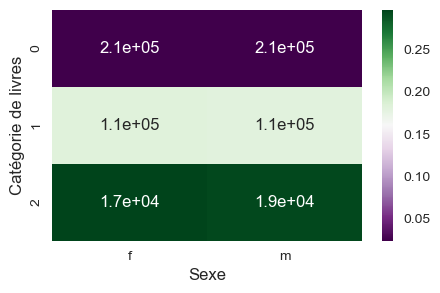

In [44]:
# Tableau croisé des deux variables avec les totaux
cont_sexe_categ_t = pd.crosstab(tcp['categ'], tcp['sex'], dropna=True, margins=True, margins_name='Total')
tx = cont_sexe_categ_t.loc[:,["Total"]]
ty = cont_sexe_categ_t.loc[["Total"],:]
n = len(tcp)
# Tableau représentant le cas d'indépendance
indep = tx.dot(ty) / n
c = cont_sexe_categ_t
measure = (c-indep)**2 / indep
# Calcul de la statistique de test ξ
xi_n = measure.sum().sum() 
table = measure / xi_n
# Tracé du heatmap
plt.figure(figsize=(5,3))
sns.heatmap(table.iloc[:-1,:-1], annot=c.iloc[:-1,:-1], cmap='PRGn')
plt.xlabel('Sexe')
plt.ylabel('Catégorie de livres')
plt.show()

Malgré que le lien soit faible, certaines obersavations peuvent être décrites : que les hommes achètent autant de produits que les femmes peu importe les catégories.<br>Par ailleurs, les livres de catégorie 0 sont ceux les plus achetés et ce dans les proportions suivantes :
- Environ **2 fois** plus que ceux de la catégorie 1
- Environ **15 fois** plus que ceux la catégorie 2


## <a name="C5"><u>2.3 Lien entre le genre et le montant des achats</u></a>
L'histogramme ci-dessous permet de visualiser la distribution du montant des achats.

In [45]:
# Histogramme de la variable 'price'
fig = px.histogram(tcp, x="price", nbins=100)
fig.update_layout(
    title_text="Distribution du montant des achats", 
    xaxis_title_text='Montant des achats', 
    yaxis_title_text="Nombre d'achats", 
    bargap=0.3,
    )
fig.show()

Avant de réaliser cette analyse, il est nécessaire de vérifier certaines conditions :
- Test de normalité de la distribution du montant des achats
- Test d'égalité des variances des différents groupes de montant des achats vis à vis du sexe

In [46]:
# Test de normailité de Shapiro-Wilk (Ho=la distribution suit une loi normale)
display(stats.shapiro(tcp['price']))

ShapiroResult(statistic=0.547275960445404, pvalue=0.0)

In [47]:
# Test d'égalité des variances (Ho=les variances sont égales)
display(stats.levene(tcp[tcp['sex']=='f']['price'], tcp[tcp['sex']=='m']['price'], center='mean'))

LeveneResult(statistic=103.20151598765192, pvalue=3.039461247325877e-24)

Au vu des résultats ci-dessus, les conditions d'application du test ANOVA ne sont pas remplies. Dès  un test de Kruskall Wallis est effectué.

In [48]:
# Test de Kruskal-Wallis (H0=les médianes de tous les groupes sont égales)
display(stats.kruskal(tcp[tcp['sex']=='f']['price'], tcp[tcp['sex']=='m']['price']))

KruskalResult(statistic=0.1593327197549315, pvalue=0.6897716097673893)

D'après le test de Kruskal-Wallis (p-value >0.05), il n'y a aucun lien entre le sexe et le montant des achats.

## <a name="C6"><u>2.4 Lien entre l’âge et le montant des achats </u></a>
Cette analyse concerne le lien entre l'âge d'un client et le montant total des achats effectués par celui-ci.

In [49]:
# Création d'un df qui contient la répartition des achats en fonction de l'âge
age_total_price=tcp.groupby('age')['price'].sum()
age_total_price=age_total_price.reset_index()
# On renomme les colonnes
age_total_price.rename(columns={'price':'total_price'}, inplace=True)
display(age_total_price.head())

,age,total_price
0,19.0,609013.690000
1,20.0,178195.780000
2,21.0,184209.264989
3,22.0,178497.700000
4,23.0,165029.256659


In [50]:
# Affichage de la répartition de la colone 'total_price' à l'aide d'un box plot
fig = px.box(age_total_price, y="total_price", labels={'total_price':'Montant des achats'},
               title="Distribution du montant total des achats")
fig.show()

In [51]:
# Affichage de la distribution à l'aide d'un scatter plot
fig = px.scatter(age_total_price, x="age", y="total_price", trendline="ols",
                 labels={'age':'Age','total_price':'Montant des achats'},
                title="Distribution du montant des achats suivant l'âge")
fig.show()

In [52]:
# Calcul du coefficient de corrélation
display(stats.pearsonr(age_total_price['age'],age_total_price['total_price']))

PearsonRResult(statistic=-0.7788603103338914, pvalue=1.198620208943365e-16)

Il y a une forte corrélation entre l'âge et le montant des achats :  plus on vieillit, plus on a tendance à moins dépenser.

## <a name="C7"><u>2.5 Lien entre l’âge et la fréquence des achats</u></a>
Le graphique ci-dessous montre la répartition de la fréquence d'achat en fonction de l'âge.

In [53]:
# On calcule le nombre d'occurences des achats en fonction de chaque âge et on le stocke dans un DF
freq_age=pd.DataFrame(tcp.groupby('age')['age'].count())
# On renomme la colonne des occurences en 'nbre_age'
freq_age.rename(columns={'age':'nbre_achat'}, inplace=True)
freq_age=freq_age.reset_index()
# Calcul du nombre total de transactions
nt_achats=len(tcp)
# Calcul de la fréquence d'achats en fonction de l'âge
freq_age['freq_age']=freq_age['nbre_achat']/nt_achats
# Vérification du alcul de la fréquence d'achats en fonction de l'âge
# print('Féqunce cumulée :',np.round(freq_age['freq_age'].sum()))

In [54]:
# Affichage de la distribution à l'aide d'un scatter plot
fig = px.scatter(freq_age, x="age", y="freq_age", trendline="ols",
                 labels={'age':'Age','freq_age':'Fréquence d\'achat'},
                title="Distribution de la fréquence d'achat suivant l'âge")
fig.show()

In [55]:
# Calcul du coefficient de corrélation
display(stats.pearsonr(freq_age['age'],freq_age['freq_age']))

PearsonRResult(statistic=-0.5337045762407476, pvalue=6.888377875054169e-07)

L'âge n'a pas une influence significative sur la fréquence des achats. Il est quand même intéressant de noter que les personnes de plus 70 ans font beaucoup moins d'achats que les autres.

## <a name="C8"><u>2.6 Lien entre l’âge et la catégorie des livres</u></a>
Le graphique ci-dessous montre la distribution du nombre d'acahts en fonction de la catégorie de livres.

In [56]:
# Affichage de la distribution
fig = px.box(tcp, x='categ',y="price")
fig.update_layout(title_text='Distribution des achats suivants les catégories de livres', 
    xaxis_title_text='Catégorie de livres', 
    yaxis_title_text='Montant des achats')
fig.show()

Avant de réaliser cette analyse, il est nécessaire de vérifier certaines conditions :
- Test de normalité de la distribution de l'âge 
- Test d'égalité des variances des différents groupes d'âge vis à vis des catégories

In [57]:
# Test de normailité de Shapiro-Wilk (Ho=la distribution suit une loi normale)
display(stats.shapiro(tcp['age']))

ShapiroResult(statistic=0.9734767079353333, pvalue=0.0)

In [58]:
# Test de l'égalité des variances (H0=les variances sont toutes égales)
display(stats.levene(tcp[tcp['categ']==0]['age'], tcp[tcp['categ']==1]['age'], tcp[tcp['categ']==2]['age']))

LeveneResult(statistic=26091.730839883516, pvalue=0.0)

Au vu des résultats ci-dessus, les conditions d'application du test ANOVA ne sont pas remplies. Dès lors un test de Kruskall Wallis est effectué : celui-ci montre qu'il y a bien un lien entre l'âge et la catégorie de livres achetés.

In [59]:
# Test de Kruskal-Wallis (H0=les médianes de tous les groupes sont égales)
display(stats.kruskal(tcp[tcp['categ']==0]['age'], tcp[tcp['categ']==1]['age'], tcp[tcp['categ']==2]['age']))

KruskalResult(statistic=79350.86927924873, pvalue=0.0)

La relation entre l'âge et la catégorie de livres est mise en évidence à l'aide d'un test du Chi2 en utilisant les différentes catégories d'âge créées plus haut.

In [60]:
# Tableau de contingence catégorie de livres / catégorie d'âge
cont_categ_age=pd.crosstab(tcp['categ'], tcp['age_group'],dropna=True)
display(cont_categ_age)

age_group,Moins de 32 ans,Entre 32 et 52 ans,Plus de 52 ans
categ,,,
0,16701,319591,79388
1,29975,98121,99073
2,33182,1486,1815


Une représentation graphique permet de mettre en évidence les répartitions.

In [61]:
fig = px.histogram(tcp, x="age_group", color="categ", barmode='group', histfunc='count',text_auto=True)
fig.update_layout(xaxis={'categoryorder':'array', 'categoryarray':list_categorie_age},
    title_text='Nomrbre d\'achats par catégories d\'âge et de livres', 
    xaxis_title_text='Catégorie d\'âge', 
    yaxis_title_text='Nombre d\'achats',)
fig.show()

In [62]:
# Test d'indépendance du chi2 (H0=L'âge n'a aucune infleuence sur la catégorie)
stats.chi2_contingency(cont_categ_age, correction=True)
stat_chi2, pvalue_chi2 = stats.chi2_contingency(
    cont_categ_age)[0], stats.chi2_contingency(cont_categ_age)[1]
print(stat_chi2,'/'*3,pvalue_chi2)

304018.0237043264 /// 0.0


La p-value du test du chi2 étant inféreure à 5%, il y a un lien entre l'âge et la catégorie de livres achetés. Cependant, il est intéressant de calculer le V_Cramer pour quantifier ce lien.

In [63]:
# Fonction de calcul du V_Cramer
def V_Cramer(table, N):
    stat_chi2 = stats.chi2_contingency(table)[0]
    k = table.shape[0]
    r = table.shape[1]
    phi = max(0,(stat_chi2/N)-((k-1)*(r-1)/(N-1)))
    k_corr = k - (np.square(k-1)/(N-1))
    r_corr = r - (np.square(r-1)/(N-1))
    return np.sqrt(phi/min(k_corr - 1,r_corr - 1))

display(V_Cramer(cont_categ_age, tcp.shape[0]))

0.473032972329078

Il y a un lien faible entre l'âge et la catégorie des produits achetés. Cette influence est mise en évidence dans la 'Heatmap' ci-dessous : 

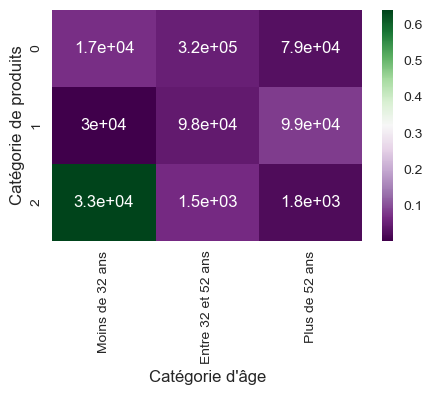

In [64]:
# Tableau croisé des deux variables avec les totaux
cont_categ_age_t = pd.crosstab(tcp['categ'], tcp['age_group'],
                               dropna=True, margins=True, margins_name='Total')
tx = cont_categ_age_t.loc[:,["Total"]]
ty = cont_categ_age_t.loc[["Total"],:]
n = len(tcp)
# Tableau représentant le cas d'indépendance
indep = tx.dot(ty) / n
c = cont_categ_age_t
measure = (c-indep)**2 / indep
# Calcul de la statistique de test ξ
xi_n = measure.sum().sum() 
table = measure / xi_n
# Tracé du heatmap
plt.figure(figsize=(5,3))
sns.heatmap(table.iloc[:-1,:-1], annot=c.iloc[:-1,:-1], cmap='PRGn')
plt.xlabel('Catégorie d\'âge')
plt.ylabel('Catégorie de produits')
plt.show()

- Les moins de 32 ans achètent deux fois plus de livres des catégories 1 et 2 que ceux de catégorie 0
- Les clients entre 32 et 52 ans achètent majoritairement ceux de la catégorie 0
- Les plus de 52 ans achètent majoritairement les livres de catégorie 0 et 1

# <u> Partie 3 : Analyse des ventes</u>
Cette partie concerne l'analyse des ventes suivants différents volets : 
- Evolution du CA
- Répartition du CA entre les clients et les produits


## <a name="C9"><u>3.1 Evolution du CA </u></a>
### 3.1.1 Evolution du CA dans le temps
Le CA global s'élève à 11.856 millions.

In [65]:
# Calcul du CA total
total_ca = tcp['price'].sum()
print('CA total :',total_ca)

CA total : 11856079.750862578


Le graphique ci-dessous présente l'évolution mensuelle du CA.

In [66]:
# DF representant les dates et montant des achats uniquement
ca_evol = tcp.loc[:,['date', 'price']]
ca_evol.set_index('date', inplace=True)
# Classement suivant les jours et mois
ca_day=ca_evol.resample('D').sum()
ca_month=ca_evol.resample('M').sum()

In [67]:
# CA suivant la catégorie 0
ca_0 = tcp.loc[tcp['categ']==0,['date','price']]
ca_0.set_index('date', inplace=True)
ca_month_0=ca_0.resample('M').sum()
# CA suivant la catégorie 1
ca_1 = tcp.loc[tcp['categ']==1,['date','price']]
ca_1.set_index('date', inplace=True)
ca_month_1=ca_1.resample('M').sum()
# CA suivant la catégorie 2
ca_2 = tcp.loc[tcp['categ']==2,['date','price']]
ca_2.set_index('date', inplace=True)
ca_month_2=ca_2.resample('M').sum()

In [68]:
display(ca_month['price'].describe())

count        24.000000
mean     494003.322953
std       41214.608803
min      320873.208308
25%      483841.759561
50%      501667.169132
75%      515748.692044
max      535688.521627
Name: price, dtype: float64

In [69]:
fig = go.Figure()
fig.add_trace(
    go.Scatter(x=ca_month.index, y=ca_month.price,name='CA total',
               line=dict(color='red')
              )
)
fig.add_trace(
    go.Scatter(x=ca_month_0.index, y=ca_month_0.price,name='CA catégorie 0',
               line=dict(color='blue')
              )
)
fig.add_trace(
    go.Scatter(x=ca_month_1.index, y=ca_month_1.price,name='CA catégorie 1',
               line=dict(color='gray')
              )
)
fig.add_trace(
    go.Scatter(x=ca_month_2.index, y=ca_month_2.price,name='CA catégorie 2',
               line=dict(color='orange')
              )
)
fig.update_layout(title="Evolution mensuelle du CA",
                 xaxis_title='Mois',
                 yaxis_title='CA réalisé par mois')
fig.show()

A partir des données ci-dessus, les informations essentielles sont les suivantes : 
- Le mois le plus rentable est celui février 2022 avec un CA de 535.57K
- Le mois le moins rentable est celui d'octobre 2021 avec un CA de 320.80K
- CA mensuel moyen de 499.40K sur l'ensemble de la période mesurée


La baisse du chiffre d'affaires en octobre 2021 s'explique par le faible nombre de transcations pour les catégories 1 et 2.

In [70]:
for var in [0, 1, 2]:
    nb_ts = tcp.loc[(tcp['year']==2021) & (tcp['categ']==var) & (tcp['month']=='October')]['date'].count()
    print("Nombre de transactions catégorie " + str(var) + " : ", nb_ts)

Nombre de transactions catégorie 0 :  18769
Nombre de transactions catégorie 1 :  1666
Nombre de transactions catégorie 2 :  1171


### 3.1.2 Etude de la tendance globale du CA

Il est également intéressant de calculer des moyennes mobiles pour mettre en évidence la tendance de l'évolution du CA. Elles seront calculées sur 7, 14 et 30 jours.

In [71]:
# Moyenne mobile sur 7, 14 et 30jours
ca_day_7=ca_day.rolling(7).mean().dropna()
ca_day_14=ca_day.rolling(14).mean().dropna()
ca_day_30=ca_day.rolling(30).mean().dropna()

In [72]:
#Affichage des moyennes mobiles
fig=go.Figure()
fig.add_trace(
    go.Scatter(x=ca_day.index, y=ca_day.price,name='CA journalier',
               line=dict(color='grey'))
)
fig.add_trace(
    go.Scatter(x=ca_day_7.index, y=ca_day_7.price,name='MA 7 jours',
               line=dict(color='green'))
)
fig.add_trace(
    go.Scatter(x=ca_day_14.index, y=ca_day_14.price,name='MA 14 jours',
               line=dict(color='yellow'))
)
fig.add_trace(
    go.Scatter(x=ca_day_30.index, y=ca_day_30.price,name='MA 30 jours',
               line=dict(color='blue'))
)
fig.update_layout(title="Evaluation de la tendance globale du CA",
                 xaxis_title='Mois',
                 yaxis_title='CA réalisé par jour')
fig.show()

D'après les différentes courbes ci-dessous, il en ressort les informations suivantes : 
-  Mars à septembre 2021 : tendance constante du CA journalier (environ à 15.5K) 
- Octobre 2021 : baisse importante du CA
- Novembre 2021 à janvier 2022 : tendance constante du CA journalier (environ à 17K) 
- Février 2022 : tendance haussière avec un pic à près de 20K de CA journalier
- De mars 2022 à février 2023 : tendance constante du CA journalier (environ à 16.5K)

### 3.1.3 Prévisions journalières du CA

Il serait également intéressant d'effectuer des prévisions journaières sur le CA. Les données utilisées pour la prédiction seront celles à partir de l'année 2022.

In [73]:
# Filtre sur l'année 2022
ca_etude = tcp.loc[(tcp['year']==2022) | (tcp['year']==2023), ['date','price']]
ca_etude.set_index('date', inplace=True)
# Classement suivant les jours et mois
ca_etude_day = ca_etude.resample('D').sum()
nb_jours = ca_etude_day.shape[0]
print("Nombre de jours étudiés : ", nb_jours)

Nombre de jours étudiés :  424


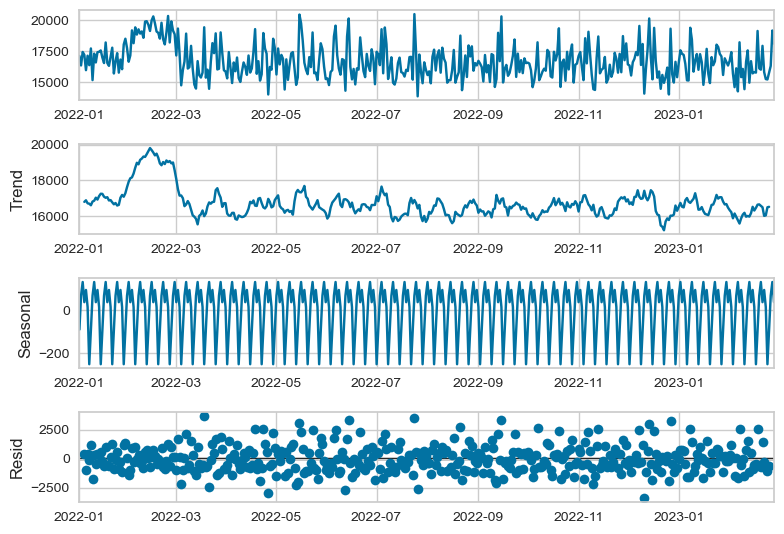

In [74]:
# Décomposition de l'évolution du CA mensuel
import statsmodels.api as sm
decompose = sm.tsa.seasonal_decompose(ca_etude_day, model='additive')
figdec = decompose.plot()

In [75]:
# Test de stationnarité (H0 : la série est non stationnaire)
from statsmodels.tsa.stattools import adfuller
results = adfuller(ca_etude_day)
print('Valeur Test ADF :',results[0])
print('Statistique du test :',results[1])

Valeur Test ADF : -3.8494050439122542
Statistique du test : 0.0024404133415202494


La série étant stationnaire (p-value < 5%), pas besoin de la différencier ; d=0 pour le modèle ARIMA. Les autres paramètres p et q du modèle sont déterminés à partir de la fonction d'autocorrélation.

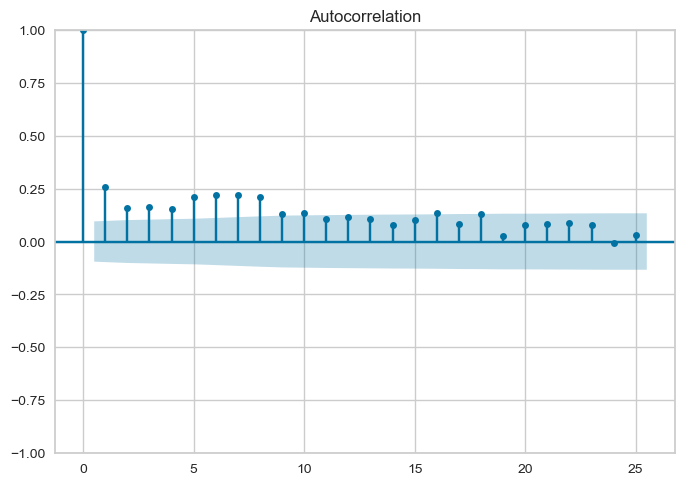

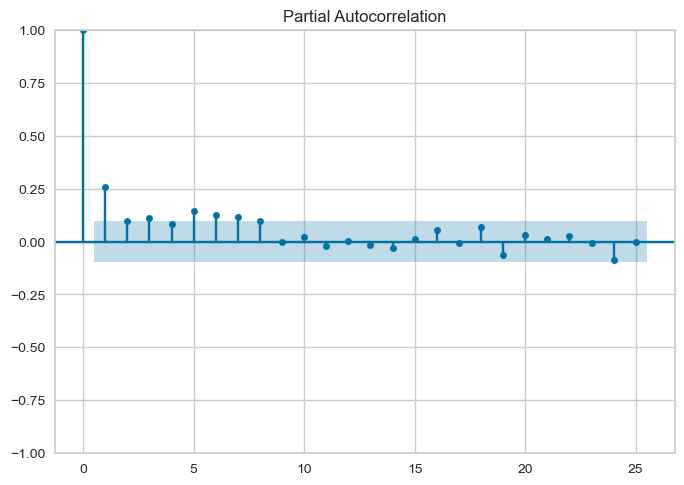

In [76]:
# Affichage de l'ACF et PACF
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf
plot_acf(ca_etude_day, lags=25, alpha=0.05)
plot_pacf(ca_etude_day, lags=25, alpha=0.05, method='ywm')
plt.show()

Au vu des fonctions d'autocorrélation, il peut s'agir d'un modèle : 
- MA (8) : ACF nulle après le 16e décalage et PACF décroit exponentiellement
- AR (2) : ACF décroit rapidement et PACF nulle après le 3e décalage
- ARIMA : il peut également s'agir d'un modèle mixte

Pour choisir le modèle adéquat, une série de test sera faite sur les critères d'information AIC et BIC pour choisir le plus faible. Les tests seront limités à l'ordre 3.

In [77]:
from statsmodels.tsa.arima.model import ARIMA
order_aic_bic = []
# Boucle pour le modèle AR(p)
for p in range(4) :
#     Boucle pour le modèle MA(q)
    for q in range(4) :
#         Modèle fit
        model = ARIMA(ca_etude_day, order=(p,0,q))
        results = model.fit()
#         On stocke l'ensemble des résultats dans une liste
        order_aic_bic.append((p, q, results.aic, results.bic))
        
# on transforme la liste en un df
ca_day_aic_bic = pd.DataFrame(order_aic_bic, columns=['p','q','AIC','BIC'])

In [78]:
ca_day_aic_bic.sort_values('AIC', ascending=True, inplace=True)
display(ca_day_aic_bic.head())

,p,q,AIC,BIC
15,3,3,7296.403914,7328.801782
14,3,2,7298.123457,7326.471591
5,1,1,7298.638199,7314.837133
11,2,3,7298.838839,7327.186973
9,2,1,7299.288679,7319.537346


Au vu des résultats ci-dessus,le modèle ARIMA(3,0,3) est retenu pour la prédiction car celui-ci a le coefficient AIC le plus bas (le critère AIC est plus adapté pour la prédiction).  

#### Split Train et Test
Les données sont séparées en deux parties : 
- Train : 80% des données de l'année 2022 pour l'entraînement soit 339 jours
- Test : 20% des données de l'année 2022 pour le test soit 85 jours

In [79]:
nb_jours_train = int(0.8*nb_jours)
train = ca_etude_day.iloc[:nb_jours_train]
test = ca_etude_day.iloc[nb_jours_train:]
print("Train size : ",train.shape)
print("Test size : ",test.shape)

Train size :  (339, 1)
Test size :  (85, 1)


#### Entraînement du modèle
Le modèle ARIMA(3,0,3) est entraîné sur le train : 

In [80]:
model = ARIMA(train, order=(3,0,3))
model = model.fit()

#### Diagnostique du modèle
Le diagnostique du modèle est fait après analyse des résultats ci-dessous.

                               SARIMAX Results                                
Dep. Variable:                  price   No. Observations:                  339
Model:                 ARIMA(3, 0, 3)   Log Likelihood               -2908.390
Date:                Wed, 31 May 2023   AIC                           5832.779
Time:                        17:35:53   BIC                           5863.387
Sample:                    01-01-2022   HQIC                          5844.977
                         - 12-05-2022                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1.676e+04    275.401     60.855      0.000    1.62e+04    1.73e+04
ar.L1         -0.0326      7.815     -0.004      0.997     -15.350      15.284
ar.L2          0.6790      4.785      0.142      0.8

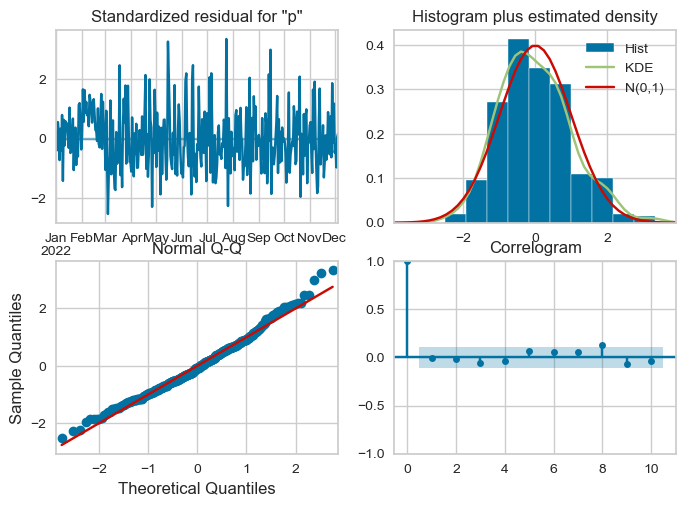

In [81]:
print(model.summary())
model.plot_diagnostics()
plt.show()

D'après les graphiques et résultats ci-dessus, le modèle est bien monté car : 
- les résidus sont stationnaires et suivent une loi normale
- les coefficients d'autocorrélation sont tous nuls après le 1er décalage

#### Test du modèle
Le modèle ARIMA(3,0,3) est testé sur le restant des jours. 

In [82]:
start = len(train)
end = start + len(test)-1
pred = model.predict(start=start, end=end)
print(pred)

2022-12-06    16668.051484
2022-12-07    16659.793294
2022-12-08    16674.828008
2022-12-09    16671.309007
2022-12-10    16679.532648
                  ...     
2023-02-24    16756.821652
2023-02-25    16756.938499
2023-02-26    16757.050194
2023-02-27    16757.156966
2023-02-28    16757.259031
Freq: D, Name: predicted_mean, Length: 85, dtype: float64


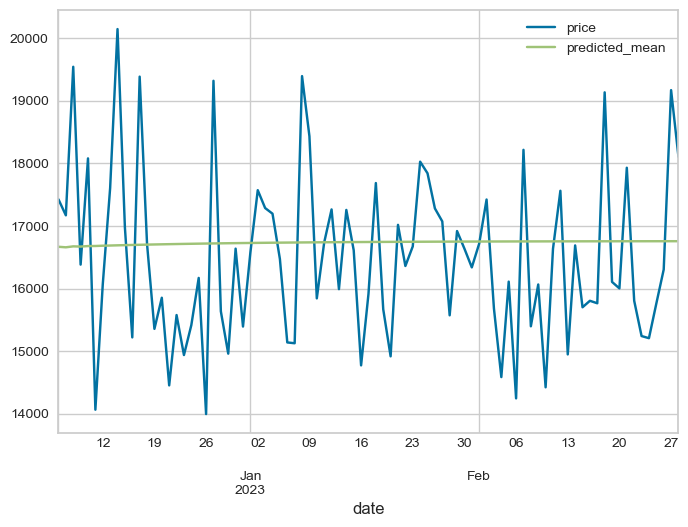

In [83]:
fig, ax = plt.subplots()
test.plot(ax=ax,legend=True)
pred.plot(ax=ax,legend=True)
plt.show()

In [84]:
from math import sqrt
from sklearn.metrics import mean_squared_error
rmse = sqrt(mean_squared_error(pred,test))
print("Test mean : ", test["price"].mean())
print("Pred mean : ", pred.mean())
print("RSME du modèle : ", rmse)

Test mean :  16504.312254174278
Pred mean :  16734.00549835582
RSME du modèle :  1374.1600592375967


Les valeurs moyennes du jeu de test et celles de la prédiction sont assez proches, comme peut le témoigner le RSME. De ce fait, le modèle peut être considéré comme cohérent. <br>
Le modèle est ensuite entraîné sur l'ensemble de la période étudiée (janvier 2022 à février 2023).

In [85]:
# Entrainement
model2 = ARIMA(ca_etude_day, order=(3,0,3))
model2 = model2.fit()

#### Prévisions sur le CA
Les prévisions sont faites sur les trois prochains moirs (92 jours), c'est-à-dire mars, avril et mai 2023.

In [86]:
start = len(ca_etude_day)
end = start + 92
pred_2023 = model2.predict(start=start, end=end-1).rename('Prevision moyenne 2023')
print(pred_2023)

2023-03-01    16580.831033
2023-03-02    16297.586393
2023-03-03    16336.650072
2023-03-04    16587.235515
2023-03-05    16879.763040
                  ...     
2023-05-27    16708.423163
2023-05-28    16708.414527
2023-05-29    16708.406508
2023-05-30    16708.399226
2023-05-31    16708.392712
Freq: D, Name: Prevision moyenne 2023, Length: 92, dtype: float64


In [87]:
print("Moyenne prévision de mars à juin", pred_2023.mean())

Moyenne prévision de mars à juin 16720.56009163815


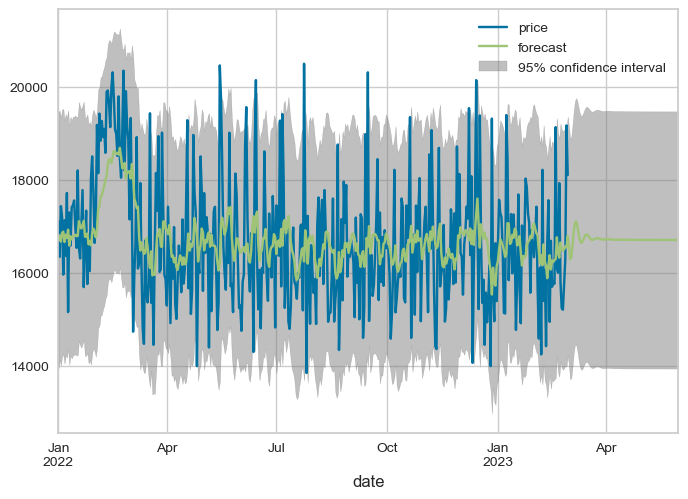

In [88]:
from statsmodels.graphics.tsaplots import plot_predict
# Affichage du CA journalier orignel et la prévision sur les 4 prochains mois
fig, ax = plt.subplots()
ca_etude_day.plot(ax=ax)
plot_predict(model2, start='2022-01-01', end='2023-05-31', ax=ax)
plt.show()

Les résultats ci-dessus présentent le CA journalier réel et les prévisions : 
- Sur la prériode de janvier 2022 à février 2023 : les prévisions moyennes sont assez proches de la réalité
- Sur la période de mars à juin 2023, les prévisions annoncent une moyenne journalière à 16716.77, ce qui est cohérent

## <a name="C10"><u>3.2 Répartition du CA </u></a>
Il y a en tout 8600 clients ayant effectué un achat sur les 8623 clients totaux.

### 3.2.1 Répartition du CA entre les clients
Il faut dans un premier temps aggréger les données pour obtenir le nombre d'achats et le CA généré par chaque client.

In [89]:
# df avec les catégories d'age de clients et le nombre d'achats par client
nb_client=tcp.groupby(['client_id','sex','age','age_group'])[['price']].count()
nb_client=nb_client.rename(columns={'price':'n_achats'})
# On ne garde que les lignes de la colonne 'price' >0 
nb_client=nb_client[nb_client['n_achats']!=0].sort_values('age')
nb_client.sort_values('n_achats',ascending=True, inplace=True)
nb_client=nb_client.reset_index()

In [90]:
# On crée un DF qui contient le chiffre d'affaire en fonction des clients
ca_client=tcp.groupby(['client_id'])[['price']].sum()
ca_client=ca_client.rename(columns={'price':'total_ca'})
# ca_client=tcp.groupby(['client_id'])[['price']].sum()
# On ne garde que les lignes de la colonne 'price' >0 
ca_client=ca_client[ca_client['total_ca']!=0].sort_values('total_ca')
ca_client=ca_client.reset_index()

In [91]:
# Jointure pour regrouper nb_client et ca_client dans un seul df
ca_client=nb_client.merge(ca_client, on='client_id')
ca_client=ca_client.loc[:,['client_id', 'sex', 'age', 'age_group', 'n_achats', 'total_ca']]

In [92]:
# Calcul du nombre total des clients
n_ca_client=len(ca_client)
# Calcul du ratio du CA par client
ca_client.sort_values('total_ca', inplace=True)
ca_client['freq']=ca_client['total_ca']/total_ca
# Calcul de la ratio cumulé du CA par client
ca_client['freq_cum']=ca_client['freq'].cumsum()

#### Courbe de Lorenz - répartition du CA entre les clients
Il devient opportun de mettre en évidence la répartition du chiffre d'affaires entre les clients à travers une courbe de Lorenz.


In [93]:
# Pour la courbe on la stocke dans l'array 'lorenz'
lorenz = np.append([0],ca_client['freq_cum'].values)
xaxis = np.linspace(0-1/n_ca_client,1+1/n_ca_client,len(lorenz)) #Il y a un segment de taille n pour chaque individu, plus 1 segment supplémentaire d'ordonnée 0. Le premier segment commence à 0-1/n, et le dernier termine à 1+1/n.

In [94]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=xaxis, y=lorenz, name='Courbe de Lorenz - CA clients'))
fig.add_trace(go.Scatter(x=[0,1],y=[0,1],name='Bissectrice'))
fig.update_layout(title="Répartition du CA à travers les clients",
                  xaxis_title_text='Proportion Clients',
                  yaxis_title_text='Proportion CA')
fig.show()

Indice de Gini ainsi obtenu :

In [95]:
AUC = (lorenz.sum() -lorenz[-1]/2 -lorenz[0]/2)/n_ca_client # Surface sous la courbe de Lorenz. Le premier segment (lorenz[0]) est à moitié en dessous de 0, on le coupe donc en 2, on fait de même pour le dernier segment lorenz[-1] qui est à moitié au dessus de 1.
S = 0.5 - AUC # surface entre la première bissectrice et le courbe de Lorenz
gini = np.round(2*S,2)
display(gini)

0.45

#### Création des catégories de clients

Le CA n'est pas réparti de façon équitable entre les clients comme l'indique l'indice de Gini. A partir de la courbe de Lorenz, environ 50% des clients sont à l'origine de 80% du CA tandis que l'autre moitié des clients ne génère que 20% du CA. <br><br>
Plus intéressant encore, le graphique ci-dessous montre qu'il y a 4 clients qui se distinguent singulièrement par le CA généré.

In [96]:
# Histogramme de la variable 'price'
fig = px.histogram(ca_client, x="total_ca") #nbins=100
fig.update_layout(
    title_text="Distribution du montant des achats", 
    xaxis_title_text='Total CA', 
    yaxis_title_text="Nombre de clients", 
    bargap=0.3,
    )
fig.show()

Des hypothèses peuvent être émises sur ces 4 clients : 
- Responsables marketing
- Revendeurs grossistes
---
Du fait de leur singularité, ces 4 clients seront traités à part dans les lignes suivantes.

In [97]:
# Df ne contenant que les 4 clients
ca_client_4 = ca_client.loc[ca_client['total_ca']>=100000]
ca_client_4 = ca_client_4.loc[:,['client_id', 'sex', 'age', 'age_group', 'n_achats', 'total_ca']]
ca_client_4.sort_values('n_achats',ascending=False, inplace=True)
# Liste des id des 4 clients
list_4 = ca_client_4['client_id'].unique().tolist()

In [98]:
# Copie du df initial
ca_client_init = ca_client.copy()
# Df ne contenant pas les 4clients
ca_client = ca_client.loc[ca_client['total_ca']<100000]
# Suppression des 4 clients du fichier de transactions
for var in list_4:
    tcp = tcp.loc[tcp['id_prod']!=var]

Le CA étant réparti de façon inéquitable entre la moitié des clients, deux catégories de clients sont créées :
- 50% des clients appartiendront à la catégorie "Classe haute"
- 50% des autres clients appartiendront à la catégorie "Classe basse" 

In [99]:
# Création des catégories de clients
list_type_client=['Classe basse','Classe haute']
ca_client['client_categ']=pd.qcut(ca_client['total_ca'], 2,
                    labels=list_type_client)
ca_client=ca_client.loc[:,['client_id', 'sex', 'age', 'age_group', 'n_achats', 'total_ca','client_categ']]

Le tableau et graphique ci-dessous représentent le nombre de clients dans chaque catégorie, ainsi que le CA réalisé par celles-ci et les proportions associées.

In [100]:
ca_client_group=ca_client.groupby('client_categ')[['total_ca']].count().merge(
                ca_client.groupby('client_categ')[['total_ca']].sum(), on='client_categ')
ca_client_group.rename(columns={'total_ca_x':'nombre','total_ca_y':'total_ca'}, inplace=True)
ca_client_group=ca_client_group.reset_index()
ca_client_group['proportion_nombre']=np.round(100*ca_client_group['nombre']/ca_client_group['nombre'].sum(),2)
ca_client_group['proportion_ca']=np.round(100*ca_client_group['total_ca']/ca_client_group['total_ca'].sum(),2)
ca_client_group=ca_client_group.loc[:,['client_categ', 'nombre', 'proportion_nombre', 'total_ca',
       'proportion_ca']]
display(ca_client_group.head())

,client_categ,nombre,proportion_nombre,total_ca,proportion_ca
0,Classe basse,4298,50.0,2.362296e+06,21.52
1,Classe haute,4298,50.0,8.612658e+06,78.48


In [101]:
# Affichage du graphique
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(
    go.Scatter(x=ca_client_group['client_categ'], y=ca_client_group['total_ca'],name='CA'),
    secondary_y=True
)
fig.add_trace(
    go.Bar(x=ca_client_group['client_categ'], y=ca_client_group['nombre'],name='Nombre de clients',
          text=ca_client_group['nombre'], marker_color='red'),
    secondary_y=False
)
fig.update_layout(title="Analyse des ventes suivant les catégories de clients")
fig.update_xaxes(title_text="Catégrorie de clients")
fig.update_yaxes(title_text="Nombre de clients", secondary_y=False)
fig.update_yaxes(title_text="Chiffre d'affaires", secondary_y=True)
fig.show()

La disparité dans la répartition du CA est nettement mise en évidence à travers le graphique ci-dessus : 50% des clients sont à l'origine d'environ 80% du CA.

### 3.2.2 Répartition du CA en fonction du type de clients

Il est devient intéressant de créer des types de clients en fonction du CA généré par ceux-ci, d'autant plus que certains clients se démarquent du lot. La nouvelle distribution du montant des achats est la suivante : 

In [102]:
# Histogramme de la variable 'price'
fig = px.histogram(ca_client, x="total_ca") #nbins=100
fig.update_layout(
    title_text="Distribution du montant des achats", 
    xaxis_title_text='Total CA', 
    yaxis_title_text="Nombre de clients", 
    bargap=0.3,
    )
fig.show()

Le montant des achats est étalé à droite, avec une moyenne des achats à 1277.

In [103]:
display(ca_client.describe())

,age,n_achats,total_ca
count,8596.000000,8596.000000,8596.000000
mean,44.739646,73.602722,1276.751218
std,16.910542,67.879195,954.427568
min,19.000000,1.000000,6.310000
25%,31.000000,27.000000,547.630000
50%,44.000000,51.000000,1026.930000
75%,57.000000,96.000000,1779.075000
max,94.000000,403.000000,5276.870000


Le graphique et coefficient de corrélation ci-dessous et montrent également qu'il y a une forte corrélation entre le nombre d'achats et le CA par clients.

In [104]:
fig=px.scatter(ca_client, x='n_achats', y='total_ca', trendline="ols",
                 labels={'n_achats':'Nombre d\'achats','total_ca':"Chiffre d'affaires"},
                 title="Chiffre d'affaires par client en fonction du nombre d'achats")
fig.show()

In [105]:
# Calcul du coefficient de corrélation
display(stats.pearsonr(ca_client['n_achats'],ca_client['total_ca']))

PearsonRResult(statistic=0.8356476855619345, pvalue=0.0)

#### Création des types de clients
Il devient donc judicieux au vu des résultats ci-dessus de créer trois types de clients en fonction du CA généré : 
- Bronze : Moins de 1030
- Argent : entre 1030 et 1800
- Or : au-delà de 1800

In [106]:
# Création des catégories de clients
list_categ_client=['Bronze','Argent','Or']
ca_client['client_type']=pd.cut(ca_client['total_ca'], bins=[0,1030,1800,1000000],
                    labels=list_categ_client, right=False)
ca_client=ca_client.loc[:,['client_id', 'sex', 'age', 'age_group', 'n_achats', 'total_ca',
                           'client_categ','client_type']]

Le tableau et graphique ci-dessous représentent le nombre de clients dans chaque type, ainsi que le CA réalisé par ceux-ci et les proportions associées.

In [107]:
# df qui contient le nombre de clients et CA par catégorie 
ca_client_type=ca_client.groupby('client_type')[['total_ca']].count().merge(
                ca_client.groupby('client_type')[['total_ca']].sum(), on='client_type')
ca_client_type.rename(columns={'total_ca_x':'nombre','total_ca_y':'total_ca'}, inplace=True)
ca_client_type=ca_client_type.reset_index()
# Calcul des proportions
ca_client_type['proportion_nombre']=np.round(100*ca_client_type['nombre']/ca_client_type['nombre'].sum(),2)
ca_client_type['proportion_ca']=np.round(100*ca_client_type['total_ca']/ca_client_type['total_ca'].sum(),2)
ca_client_type=ca_client_type.loc[:,['client_type', 'nombre', 'proportion_nombre', 'total_ca',
       'proportion_ca']]
display(ca_client_type.head())

,client_type,nombre,proportion_nombre,total_ca,proportion_ca
0,Bronze,4313,50.17,2.377720e+06,21.66
1,Argent,2179,25.35,2.997544e+06,27.31
2,Or,2104,24.48,5.599689e+06,51.02


In [108]:
# Affichage du graphique
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(
    go.Scatter(x=ca_client_type['client_type'], y=ca_client_type['total_ca'],name='CA'),
    secondary_y=True
)
fig.add_trace(
    go.Bar(x=ca_client_type['client_type'], y=ca_client_type['nombre'],name='Nombre de clients',
          text=ca_client_type['nombre'], marker_color='red'),
    secondary_y=False
)
fig.update_layout(title="Analyse des ventes suivant le type de clients")
fig.update_xaxes(title_text="Type de clients")
fig.update_yaxes(title_text="Nombre de clients", secondary_y=False)
fig.update_yaxes(title_text="Chiffre d'affaires", secondary_y=True)
fig.show()

- Les clients "Or" (25% du total) sont deux fois moins nombreux que les clients "Bronze" et réussissent à générer deux fois plus de CA (50% du total) que ceux-ci
- Les clients "Argent" sont également deux fois moins nombreux que les clients "Bronze" et génèrent un peu plus de CA (27%) que les clients "Bronze" (22%)

### 3.2.3 Répartition du CA en fonction du sexe

Le chiffre d'affaire est réparti de façon à peu près équitable en fonction du sexe comme le montre le graphique ci-dessous. Il y à peu près autant de clients féminins que masculins.

In [109]:
sexe_ca=tcp.groupby('sex')[['price']].count().merge(
        tcp.groupby('sex')[['price']].sum(), on='sex')
sexe_ca.rename(columns={'price_x':'nombre','price_y':'total_ca'}, inplace=True)
sexe_ca=sexe_ca.reset_index()
# On renomme les colonnes
sexe_ca.rename(columns={'price':'total_ca'}, inplace=True)
# Calcul des propotions
sexe_ca.insert(2,'proportion_nombre',np.round(100*sexe_ca['nombre']/sexe_ca['nombre'].sum(),2))
sexe_ca.insert(4,'proportion_ca',np.round(100*sexe_ca['total_ca']/total_ca,2))
display(sexe_ca)

,sex,nombre,proportion_nombre,total_ca,proportion_ca
0,f,338402,49.81,5.860928e+06,49.43
1,m,340930,50.19,5.995152e+06,50.57


In [110]:
# Affichage du graphique
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(
    go.Scatter(x=sexe_ca['sex'], y=sexe_ca['total_ca'],name='CA'),
    secondary_y=True
)
fig.add_trace(
    go.Bar(x=sexe_ca['sex'], y=sexe_ca['nombre'],name='Nombre de clients',
          text=sexe_ca['nombre'], marker_color='red'),
    secondary_y=False
)
fig.update_layout(title="Analyse du CA suivant le sexe")
fig.update_xaxes(title_text="Sexe")
fig.update_yaxes(title_text="Nombre d'achats", secondary_y=False)
fig.update_yaxes(title_text="Chiffre d'affaires", secondary_y=True)
fig.show()

Il n'y a pas une grande disparité entre au niveau de :
- CA généré par les hommes (50.57%) et les femmes (49.43%)
- La proportion des hommes (50.19%) et des femmes (49.81%) 

### 3.2.4 Répartition du CA en fonction de la catégorie d'âge
Le tableau et graphique ci-dessous représentent le nombre de clients dans chaque catégorie d'âge, ainsi que le CA réalisé par celles-ci et les proportions associées.

In [111]:
# df qui contient le nombre de clients et CA par catégorie d'âge
ca_client_age=ca_client.groupby('age_group')[['total_ca']].count().merge(
                ca_client.groupby('age_group')[['total_ca']].sum(), on='age_group')
ca_client_age.rename(columns={'total_ca_x':'nombre','total_ca_y':'total_ca'}, inplace=True)
ca_client_age=ca_client_age.reset_index()
# Calcul des proportions
ca_client_age['proportion_nombre']=np.round(100*ca_client_age['nombre']/ca_client_age['nombre'].sum(),2)
ca_client_age['proportion_ca']=np.round(100*ca_client_age['total_ca']/ca_client_age['total_ca'].sum(),2)
ca_client_age=ca_client_age.loc[:,['age_group', 'nombre', 'proportion_nombre', 'total_ca',
       'proportion_ca']]
display(ca_client_age.head())

,age_group,nombre,proportion_nombre,total_ca,proportion_ca
0,Moins de 32 ans,2266,26.36,3.005142e+06,27.38
1,Entre 32 et 52 ans,3365,39.15,5.214603e+06,47.51
2,Plus de 52 ans,2965,34.49,2.755209e+06,25.10


In [112]:
# Affichage du graphique
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(
    go.Scatter(x=ca_client_age['age_group'], y=ca_client_age['total_ca'],name='CA'),
    secondary_y=True
)
fig.add_trace(
    go.Bar(x=ca_client_age['age_group'], y=ca_client_age['nombre'],name='Nombre de clients',
          text=ca_client_age['nombre'], marker_color='red'),
    secondary_y=False
)
fig.update_layout(title="Analyse des ventes suivant les catégories d'âge")
fig.update_xaxes(title_text="Catégrorie d'âge")
fig.update_yaxes(title_text="Nombre de clients", secondary_y=False)
fig.update_yaxes(title_text="Chiffre d'affaires", secondary_y=True)
fig.show()

Près de 50% du CA est généré par les clients entre 33 et 52 ans ; ceux-ci représentent environ 40% de l'ensemble des clients.

### 3.2.5 Répartition du CA entre les clients exceptionnels
Les clients "exceptionnels" ici sont les 4 clients mentionnés plus haut et qui génèrent plus de 100000 de CA chacun.

In [113]:
display(ca_client_4.head())

,client_id,sex,age,age_group,n_achats,total_ca
8599,c_1609,m,43.0,Entre 32 et 52 ans,25488,324033.350000
8598,c_6714,f,55.0,Plus de 52 ans,9187,153662.749978
8597,c_3454,m,54.0,Plus de 52 ans,6773,113669.844989
8596,c_4958,m,24.0,Moins de 32 ans,5195,289760.340000


In [114]:
# Affichage du graphique
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(
    go.Scatter(x=ca_client_4['client_id'], y=ca_client_4['total_ca'],name='CA'),
    secondary_y=True
)
fig.add_trace(
    go.Bar(x=ca_client_4['client_id'], y=ca_client_4['n_achats'],name="Nombre d'achats",
          text=ca_client_4['n_achats'], marker_color='red'),
    secondary_y=False
)
fig.update_layout(title="Analyse des ventes des clients exceptionnels")
fig.update_xaxes(title_text="Client ID")
fig.update_yaxes(title_text="Nombre d'achats", secondary_y=False)
fig.update_yaxes(title_text="Chiffre d'affaires", secondary_y=True)
fig.show()

In [115]:
# Total CA des 4 clients et proportion par rapport au CA global
total_ca_4 = np.round(ca_client_4['total_ca'].sum(),2)
prop_4 = np.round(100*total_ca_4/total_ca,2)
print("Total CA des 4 clients : ", total_ca_4)
print("Proportion par rapport au CA global : ", prop_4)

Total CA des 4 clients :  881126.28
Proportion par rapport au CA global :  7.43


Ces 4 clients sont responsables à eux seuls de 7% du CA global, soit environ 881126.

## 3.3 Répartition du CA en fonction des produits
### 3.3.1 Répartition du CA en fonction des catégorie de livres

#### Répartition des catégories en fonction du nombre de ventes
Le tableau ci-dessous représente le nombre de ventes et chiffre d'affaires ainsi que les proportions associées en fonction des différentes catégories.

In [116]:
# Création d'un df qui contient le nombre de ventes en fonction de la catégorie
categ_nbre=tcp.groupby(['categ'])['price'].count()
categ_nbre=categ_nbre.reset_index()
# On renomme les colonnes
categ_nbre.rename(columns={'price':'n_ventes'}, inplace=True)
categ_nbre['proportion_ventes']=np.round(100*categ_nbre['n_ventes']/len(tcp),2)
# Création d'un df qui contient le nombre d'achats et CA en fonction de la catégorie
categ_ca=tcp.groupby(['categ'])['price'].sum()
categ_ca=categ_ca.reset_index()
# On renomme les colonnes
categ_ca.rename(columns={'price':'total_ca'}, inplace=True)
categ_ca=categ_nbre.merge(categ_ca, on='categ')
categ_ca['proportion_ca']=np.round(100*categ_ca['total_ca']/total_ca,2)
display(categ_ca)

,categ,n_ventes,proportion_ventes,total_ca,proportion_ca
0,0,415680,61.19,4.422082e+06,37.30
1,1,227169,33.44,4.653723e+06,39.25
2,2,36483,5.37,2.780275e+06,23.45


Le graphique ci-dessous présente le nombre de ventes suivant la catégorie de livres, ainsi que le CA généré.

In [117]:
# Création d'un df qui contient le nombre d'achats en fonction du produit
prod_achat=tcp.groupby(['id_prod','categ'])['price'].count()
prod_achat=prod_achat.reset_index()
# On ne garde que les lignes de la colonne 'price' >0 
prod_achat=prod_achat[prod_achat['price']!=0].sort_values('price')
# On renomme les colonnes
prod_achat.rename(columns={'price':'n_ventes'}, inplace=True)
prod_achat.sort_values('n_ventes',ascending=False, inplace=True)
prod_achat=prod_achat.reset_index(drop=True)

In [118]:
# Affichge du graphique
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(
    go.Scatter(x=categ_ca['categ'], y=categ_ca['total_ca'],name='CA'),
    secondary_y=True
)
fig.add_trace(
    go.Bar(x=categ_ca['categ'], y=categ_ca['n_ventes'],name='Nombre de ventes',
          text=categ_ca['n_ventes'], marker_color='red'),
    secondary_y=False
)
fig.update_layout(title='Analyse des ventes suivant les catégories')
fig.update_xaxes(title_text="Catégrories de livres")
fig.update_yaxes(title_text="Nombre de ventes", secondary_y=False)
fig.update_yaxes(title_text="Chiffre d'affaires", secondary_y=True)
fig.show()

Concernant les catégories de livres, les observations suivantes ont été faites : 
- La catégorie 0 est la plus vendue (61% des ventes) mais génère un peu moins de CA (37%) que la catégorie 1 qui elle est environ deux fois moins vendue que la catégorie 0
- La catégorie 2 est très peu vendue (5% des ventes) mais génère 23% du CA.

### 3.3.2 Répartition du CA en fonction des classes de produits
Sur les 3287 produits totaux, 3265 produits ont été vendus au moins une fois.

In [119]:
# Création d'un df qui contient le CA en fonction du produit
prod_ca = tcp.groupby('id_prod')['price'].sum()
prod_ca = prod_ca.reset_index()
# On renomme les colonnes
prod_ca.rename(columns={'price':'total_ca'}, inplace=True)
# Calcul du nombre total des produits
n_prod_ca = len(prod_ca)
# Calcul de la fréquence  des achats par clients
prod_ca.sort_values('total_ca', inplace=True)
prod_ca = prod_ca.reset_index(drop=True)
prod_ca['freq'] = prod_ca['total_ca'] / total_ca
# Calcul de la fréquence cumulée des achats par clients
prod_ca['freq_cum'] = prod_ca['freq'].cumsum()
prod_ca = prod_ca.merge(prod_achat, on='id_prod').merge(products,on=['id_prod','categ'])
prod_ca = prod_ca.loc[:,['id_prod','categ','price','n_ventes','total_ca','freq','freq_cum']]
print("Nombre de produits vendus au moins une fois : ", prod_ca.shape[0])
print()

Nombre de produits vendus au moins une fois :  3265



Le graphique et coefficient de corrélation ci-dessous mettent en évidence le fait que le CA généré par chaque produit est proportionnel au nombre de ventes réalisées.

In [120]:
fig=px.scatter(prod_ca, x='n_ventes', y='total_ca', trendline='ols')
fig.update_layout(title_text='CA en fonction du nombre de ventes des produits', 
    xaxis_title_text='Nombre de ventes', 
    yaxis_title_text='CA généré')
fig.show()

In [121]:
display(stats.pearsonr(prod_ca['total_ca'],prod_ca['n_ventes']))

PearsonRResult(statistic=0.7531113310173988, pvalue=0.0)

#### Courbe de Lorenz - répartition du CA entre les produits
Il devient judicicieux de mettre en évidence la répartition du chiffre d'affaires entre les produits à travers une courbe de Lorenz.


In [122]:
# Pour la courbe on la stocke dans l'array 'lorenz'
lorenz = np.append([0], prod_ca['freq_cum'].values)
xaxis = np.linspace(0-1/n_prod_ca, 1+1/n_prod_ca, len(lorenz)) #Il y a un segment de taille n pour chaque individu, plus 1 segment supplémentaire d'ordonnée 0. Le premier segment commence à 0-1/n, et le dernier termine à 1+1/n.

In [123]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=xaxis, y=lorenz, name='Courbe de Lorenz - CA prouits'))
fig.add_trace(go.Scatter(x=[0,1], y=[0,1], name='Bissectrice'))
fig.update_layout(title="Répartition du CA en fonction des produits",
                  xaxis_title_text='Proportion Produits',
                  yaxis_title_text='Proportion CA')
fig.show()

Indice de Gini ainsi obtenu : 

In [124]:
AUC = (lorenz.sum() -lorenz[-1]/2 -lorenz[0]/2)/n_prod_ca # Surface sous la courbe de Lorenz. Le premier segment (lorenz[0]) est à moitié en dessous de 0, on le coupe donc en 2, on fait de même pour le dernier segment lorenz[-1] qui est à moitié au dessus de 1.
S = 0.5 - AUC # surface entre la première bissectrice et le courbe de Lorenz
gini = np.round(2*S, 2)
display(gini)

0.74

Le CA est réparti de façon inéquitable entre les produits. En effet, près de 20% des produits génèrent à eux seuls près de 80% du CA total.

#### Création des classes de produits
La distribution du montant des achats générés par chaque produit est ainsi obtenue :

In [125]:
# Histogramme de la variable 'price'
fig = px.histogram(prod_ca, x="total_ca") #nbins=100
fig.update_layout(
    title_text="Distribution du montant des achats", 
    xaxis_title_text='Total CA', 
    yaxis_title_text="Nombre de produits", 
    bargap=0.3,
    )
fig.show()

Elle est étalée à droite avec des valeurs qui sont très singulières.

In [126]:
display(prod_ca['total_ca'].describe())

count     3265.000000
mean      3630.544772
std       7371.925385
min          0.990000
25%        233.820000
50%        796.860000
75%       3408.600000
max      94893.500000
Name: total_ca, dtype: float64

Au vu des résultats ci-dessus, les produits sont classés en 3 classes en fonction du CA : 
- Low Ticket : inférieur à 3410
- Medium Ticket : entre 3410 et 8100
- High Ticket : supérieur à 8100

In [127]:
# Création des catégories
list_categ_prod=['Low Ticket','Meidum Ticket','High Ticket']
prod_ca['ca_group']=pd.cut(prod_ca['total_ca'], bins=[0,3410,8100,100000],
                    labels=list_categ_prod, right=False)
prod_ca=prod_ca.loc[:,['id_prod', 'categ', 'price', 'n_ventes', 'total_ca','ca_group']]

Le tableau ci-dessous représente le nombre de produits,le CA et les proportions associées en fonction des différentes classes de produit.

In [128]:
# df contenant le nombre, CA et proportion suivant la catégorie de produits
prod_ca_group=prod_ca.groupby('ca_group')[['total_ca']].count().merge(
                prod_ca.groupby('ca_group')[['total_ca']].sum(), on='ca_group')
prod_ca_group.rename(columns={'total_ca_x':'nombre','total_ca_y':'total_ca'}, inplace=True)
prod_ca_group=prod_ca_group.reset_index()
# Calcul des proportions
prod_ca_group['proportion_nombre']=np.round(100*prod_ca_group['nombre']/prod_ca_group['nombre'].sum(),2)
prod_ca_group['proportion_ca']=np.round(100*prod_ca_group['total_ca']/prod_ca_group['total_ca'].sum(),2)
prod_ca_group=prod_ca_group.loc[:,['ca_group', 'nombre', 'proportion_nombre', 'total_ca',
       'proportion_ca']]
display(prod_ca_group.head())

,ca_group,nombre,proportion_nombre,total_ca,proportion_ca
0,Low Ticket,2449,75.01,1943937.18,16.4
1,Meidum Ticket,413,12.65,2145478.10,18.1
2,High Ticket,403,12.34,7764313.40,65.5


In [129]:
# Affichage du graphique
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(
    go.Scatter(x=prod_ca_group['ca_group'], y=prod_ca_group['total_ca'],name='CA'),
    secondary_y=True
)
fig.add_trace(
    go.Bar(x=prod_ca_group['ca_group'], y=prod_ca_group['nombre'],name='Nombre de produits',
          text=prod_ca_group['nombre'], marker_color='red'),
    secondary_y=False
)
fig.update_layout(title="Analyse des ventes suivant les catégories de produits")
fig.update_xaxes(title_text="Catégrorie de produits")
fig.update_yaxes(title_text="Nombre de produits", secondary_y=False)
fig.update_yaxes(title_text="Chiffre d'affaires", secondary_y=True)
fig.show()

Le constat est clair et net : 
- La catégorie High Ticket génère pour seulement 12% des produits près de 65% du CA.
- La catégorie Low Ticket génère pour près de 75% des produits moins de 20% du CA.
- On a bien un effet Paretto : environ 25% des produits (High et Low ticket) génèrent à eux seuls un peu plus de 80% du CA

# <u> Partie 4 : Segmentation des clients</u>
Cette partie concerne la segmentation de clients suivants plusieurs criètres.

## <a name="C11"><u>4.1 Scoring RFM </u></a>
Le scoring RFM permet de classer les clients en fonction de : 
- La Récence : nombre de jours depuis le dernier achat
- La Fréquence : nombre d'achats durant les 12 derniers mois
- Montant : montant total des achats effectués durant les 12 derniers mois
---
Les calculs seront effectués à partir du jour suivant le dernier jour enregistré dans les transactions. La méthode utilisée sera celle des quantiles.

In [130]:
# Calcul du jour suivant le dernier jour enregistré dans les transactions
rfm_date = max(tcp.date) + datetime.timedelta(days=1)

In [131]:
# Aggrégation des données par client_id
tcp_rfm = tcp.groupby(['client_id']).agg({
    "date": lambda x: (rfm_date - x.max()).days, # Calcul de la Récence
    "client_id": 'count', # Calcul de la Fréquence
    "price": 'sum' # Calcul du Montant
})
# Renommage des colonnes 
tcp_rfm.rename(columns={"date":"Récence","client_id":"Fréquence","price":"Montant"}, inplace=True)

In [132]:
tcp_rfm_score = tcp_rfm.copy()
# Création du scoring "R" pour la "Récence"
r_labels = range(4,0,-1) # Découpage en 4 classes (4 quantiles) : plus la récence est faile, plus R est haut
# Création du scoring "F" pour la "Fréquence"
f_labels = range(1,5)
# Création du scoring "M" pour le "Montant"
m_labels = range(1,5)
# Création des colonnes + conversion en entier
tcp_rfm_score['R']=pd.qcut(tcp_rfm_score['Récence'], 4, labels=r_labels).astype('category')
tcp_rfm_score['F']=pd.qcut(tcp_rfm_score['Fréquence'], 4, labels=f_labels).astype('category')
tcp_rfm_score['M']=pd.qcut(tcp_rfm_score['Montant'], 4, labels=m_labels).astype('category')

In [133]:
# Création d'une fonction pour la définition des scores
def join_rfm(x): return str(x['R']) + str(x['F']) + str(x['M']) # Concatenation des chiffres
tcp_rfm_score['RFM_Segment'] = tcp_rfm_score.apply(join_rfm, axis=1) # Application de la fonction
tcp_rfm_score['RFM_Score'] = tcp_rfm_score[['R','F','M']].sum(axis=1) # Calcul du score (somme des chiffres R, F et M) 

Le tableau ci-dessous présente les différents indicateurs ainsi que le segment et score RFM.

In [134]:
display(tcp_rfm_score.head())

,Récence,Fréquence,Montant,R,F,M,RFM_Segment,RFM_Score
client_id,,,,,,,,
c_1,45,39,558.18,1,2,2,1.02.02.0,5
c_10,33,58,1353.60,2,3,3,2.03.03.0,8
c_100,162,8,254.85,1,1,1,1.01.01.0,3
c_1000,36,125,2261.89,2,4,4,2.04.04.0,10
c_1001,6,102,1812.86,4,4,4,4.04.04.0,12


## <a name="C12"><u>4.2 Segmentation RFM </u></a>
La segmentation est faite à l'aide de l'algorithme non supervisé K-means. Celle-ci permettra de classer les clients en fonction des indicateurs RFM.

#### Preprocessing
Avant l'application du K-means, un prétraitement des données est nécessaire. Cela débute par l'analyse de la distribution des variables R,F et M.

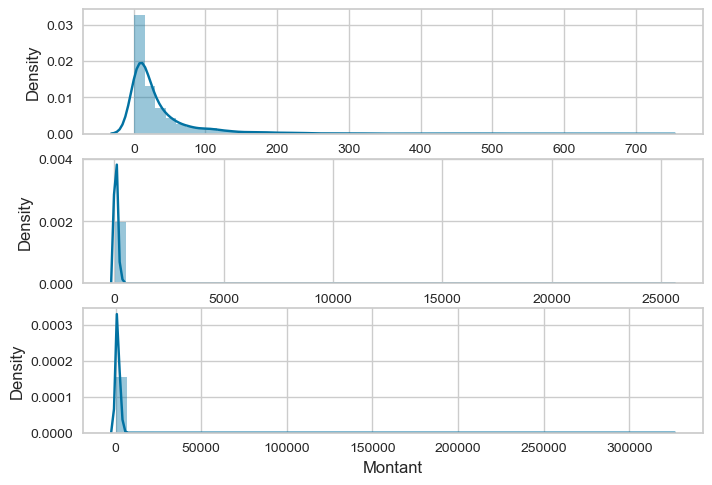

In [135]:
# Plot distribution of R
plt.subplot(3, 1, 1); sns.distplot(tcp_rfm['Récence'])
# Plot distribution of F
plt.subplot(3, 1, 2); sns.distplot(tcp_rfm['Fréquence'])
# Plot distribution of M
plt.subplot(3, 1, 3); sns.distplot(tcp_rfm['Montant'])
# Show the plot
plt.show()

Les distributions des différentes variables R,F et M étant étalées à droites, il faut les rapprocher d'une loi normale en appliquant une fonction logarithmique.

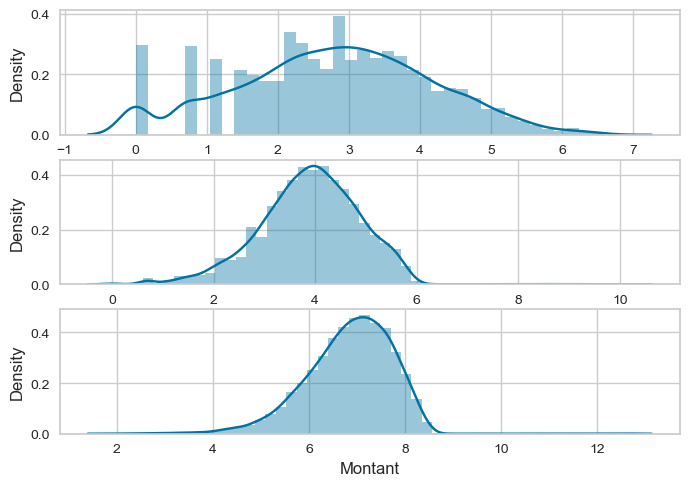

In [136]:
# Transformation logarithmique
tcp_rfm_log=np.log(tcp_rfm[['Récence','Fréquence','Montant']])
# Plot distribution of R
plt.subplot(3, 1, 1); sns.distplot(tcp_rfm_log['Récence'])
# Plot distribution of F
plt.subplot(3, 1, 2); sns.distplot(tcp_rfm_log['Fréquence'])
# Plot distribution of M
plt.subplot(3, 1, 3); sns.distplot(tcp_rfm_log['Montant'])
# Show the plot
plt.show()

#### Standardisation
Les données sont centrées, réduites et standardisées.

In [137]:
# Les données sont stockées dans la matrice de données X
X = tcp_rfm_log.values

In [138]:
# Initialize a scaler
scaler = StandardScaler()
# Fit and transform the scaler
X_scaled = scaler.fit_transform(X)

#### K-means
Le nombre de centroïdes K sont déterminés par la méthode du coude.

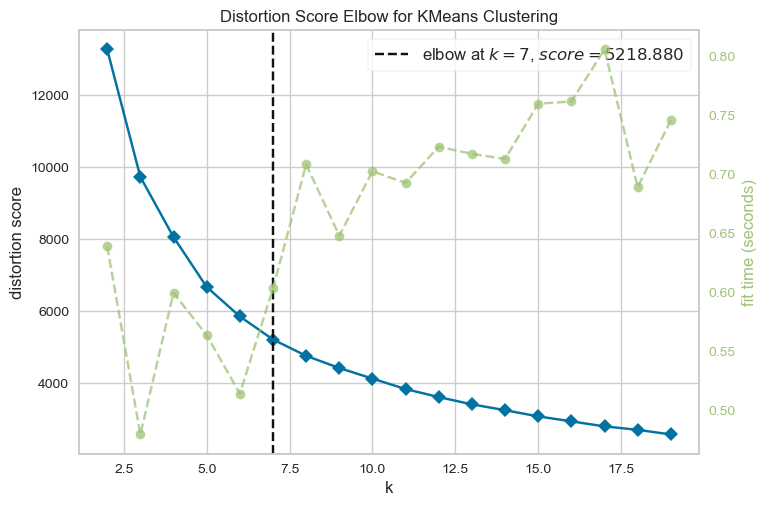

In [139]:
model = KMeans()
# Visualisation de la variation de l'inertie intraclasse en fonction du nombre de clusters
visualizer = KElbowVisualizer(model, k=(2,20))
visualizer.fit(X_scaled)
visualizer.show();

Le modèle est entrainé sur la base des **7 clusters** définis.

In [140]:
model = KMeans(n_clusters=7, random_state=1)
model.fit(X_scaled)
clusters=model.predict(X_scaled)
display(clusters)

array([1, 0, 4, ..., 0, 5, 1])

Les clusters sont ensuite ajoutés au tableau des valeurs initiales.

In [141]:
# Création d'un df contenant les données R,F,M intiales et les clusters
tcp_rfm_k = tcp_rfm.copy()
# Ajout de la colonne clusters aux données initiales
tcp_rfm_k["clusters"] = clusters
tcp_rfm_k["clusters"] = tcp_rfm_k["clusters"].astype(str)
display(tcp_rfm_k.head())

,Récence,Fréquence,Montant,clusters
client_id,,,,
c_1,45,39,558.18,1
c_10,33,58,1353.60,0
c_100,162,8,254.85,4
c_1000,36,125,2261.89,0
c_1001,6,102,1812.86,5


In [142]:
# Ajout de la colonne clusters aux données initiales avec les scores
tcp_rfm_score["clusters"] = clusters
tcp_rfm_score["clusters"] = tcp_rfm_score["clusters"].astype(str)
tcp_rfm_score_k = tcp_rfm_score.groupby(['clusters'])[['RFM_Score']].sum()
tcp_rfm_score_k.sort_values('RFM_Score', inplace=True)
display(tcp_rfm_score_k)

,RFM_Score
clusters,
3,841
4,3724
6,6983
1,9187
5,10775
2,14154
0,19098


Au vu du grand nombre de clusters trouvé, il est plus facile de les interpréter en utilisant la méthode de **l'importance relative des attributs RFM**. En effet, elle permet de comparer la moyenne de chaque attribut dans un cluster donné, par rapport à la moyenne générale de tous les clusters.

In [143]:
# Calculate average RFM values for each cluster
cluster_avg = tcp_rfm_k.groupby(['clusters']).mean() 
# Calculate average RFM values for the total customer population
population_avg = tcp_rfm.mean()
# Calculate relative importance of cluster's attribute value compared to population
relative_imp = cluster_avg / population_avg - 1

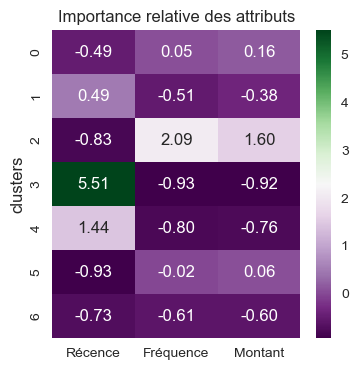

In [144]:
# Initialize a plot with a figure size of 8 by 2 inches 
plt.figure(figsize=(4, 4))
# Add the plot title
plt.title('Importance relative des attributs')
# Plot the heatmap
sns.heatmap(data=relative_imp, annot=True, fmt='.2f', cmap='PRGn')
plt.show()

- Le cluster 3 est celui qui a acheté le plus récemment, dépense le moins et achète le moins fréquemment
- Le cluster 2 est celui qui achète le plus fréquemment et dépense le plus
- Le cluster 5 est celui qui a acheté le moins fréquemment

# <u> Partie 5 : Conclusion</u>
Parvenus au terme de cette analyse, il en ressort des informations qui ont été synthétisées dans les lignes suivantes.<br>
Néanmoins, il convient de préciser que l'étude aurait pu être approfondie si les datasets contenaient des informations comme :
- La catégorie socio-professionnelle des clients (métier et salaires annuels par exemple)
- Lieu de résidence des clients
- Leur situation matrimoniale...

## <a name="C13"><u>5.1 Analyse synthétique</u></a>
#### Chiffre d'affaires
Le CA total est d'environ 11.856 millions et le CA mensuel moyen est d'environ 499K. Celui-ci est majoritairement influencé par les types de clients "Argent et Or" ainsi que par les produits de catégorie "High Ticket". Le mois le plus rentable est celui de février 2022 et le moins rentable celui d'octobre 2021.
#### Clients
Il y a autant d'hommes que de femmes. Le sexe n'a pas d'influence sur le montant des achats, mais l'âge par contre si : plus on vieillit moins on a tendance à dépenser. Les meilleurs clients sont ceux entre 32 et 52 ans. A noter que 50% des clients sont responsables de 80% du CA.
#### Produits
La catégorie de livre la plus rentable est de loin la catégorie 1. Celle la plus vendue est la catégorie 0 et celle la moins vendue est la catégorie 2. Seuls 25% des produits sont responsables de 80% du CA.
#### Segmentation
Les groupes de clusters sont assez hétérogènes avec une singularité sur le cluster 3 : ce groupe a acheté le plus récemment, dépense le moins et achète le moins fréquemment

## <a name="C14"><u>5.2 Recommandations</u></a>
Nous recommandons la mise en place des actions suivantes :
- Faire des offres promotionnelles aux clients âgés entre 33 et 52 ans pour les inciter à encore plus acheter
- Améliorer le Marketing des produits High et Low Ticket
- Proposer plus de livres de catégorie 0 et 1
- Proposer des offres commerciales pour inciter les clients du cluster 3 à acheter plus fréquemment
- Relancer les clients du cluster 5 avec des offres hallechantes pour les faire acheter plus que d'habitdue
- Continuer à proposer des offres au cluster 2 et 6 pour les garder actifs